In [8]:
import rasterio
import numpy as np
from pathlib import Path
import osmnx as ox
from rasterio.features import rasterize
import matplotlib.pyplot as plt

In [4]:
DATASET_DIR = Path("datasets")

BUILDING_DATASET_DIR = DATASET_DIR / "building_footprints"
BUILDING_DATASET_DIR.mkdir(parents=True, exist_ok=True)

SENTINEL_DATASET_DIR = DATASET_DIR / "sentinel"

In [6]:
def normalize(img):
    masked_data = np.ma.masked_equal(img, 0)
    lq, uq = np.quantile(masked_data.compressed(), (0.01, 0.99))
    image_norm = np.clip(img, a_min=lq, a_max=uq)
    image_norm = (image_norm - lq) / (uq - lq)
    return image_norm

In [4]:
bologna_gdf = ox.geocode_to_gdf("Bologna, Italy")
bologna_gdf.envelope.explore()

In [5]:
bbox = {
    "north": bologna_gdf.bbox_north[0],
    "south": bologna_gdf.bbox_south[0],
    "east": bologna_gdf.bbox_east[0],
    "west": bologna_gdf.bbox_west[0]
}
bolognia_features = ox.features_from_bbox(north=bbox["north"], south=bbox["south"], east=bbox["east"], west=bbox["west"], tags={'building':True})

/var/folders/3d/xpgdbrds7vj7yrmsdd8vdjlw0000gn/T/ipykernel_88561/3545391186.py:7: FutureWarning: The `north`, `south`, `east`, and `west` parameters are deprecated and will be removed in the v2.0.0 release. Use the `bbox` parameter instead.
  bolognia_features = ox.features_from_bbox(north=bbox["north"], south=bbox["south"], east=bbox["east"], west=bbox["west"], tags={'building':True})


In [6]:


r_file = rasterio.open(SENTINEL_DATASET_DIR / "R.tiff")

bolognia_features = bolognia_features.to_crs(r_file.crs)

meta = r_file.meta.copy()
meta.update(compress='lzw')
with rasterio.open(BUILDING_DATASET_DIR / "footprint.tiff", "w", **meta) as f:
    buildings_raster = rasterize(
        [(geom, 1) for geom in bolognia_features.geometry],
        fill=0,
        out_shape=r_file.shape,
        transform=f.transform,
        dtype='uint8'
    )
    f.write(buildings_raster, 1)
plt.imshow(buildings_raster, cmap="gray")

RasterioIOError: datasets/sentinel/R.tiff: No such file or directory

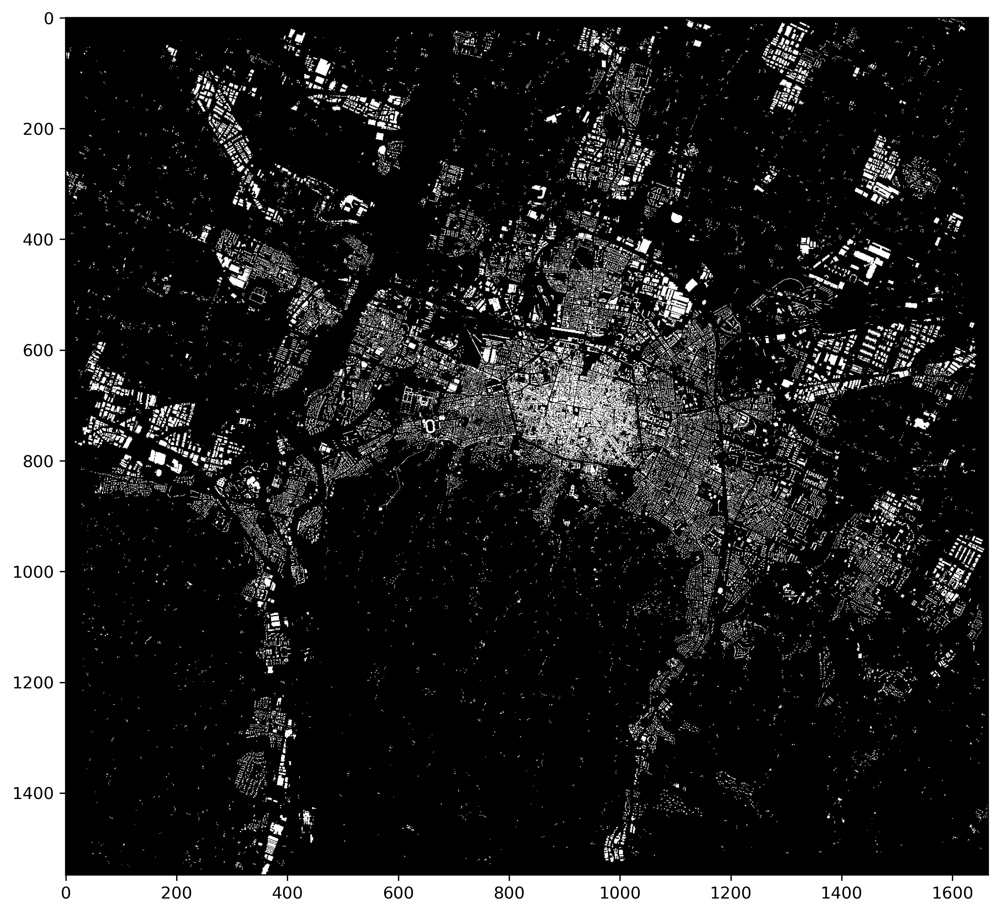

In [62]:
bologna_building_dir = BUILDING_DATASET_DIR / "bologna"
bologna_sentinel_dir = SENTINEL_DATASET_DIR / "bologna"
buildings_raster = rasterio.open(bologna_building_dir / "footprint.tiff").read().squeeze()

plt.figure(figsize=(10, 10), dpi=300)
plt.imshow(buildings_raster, cmap="gray")

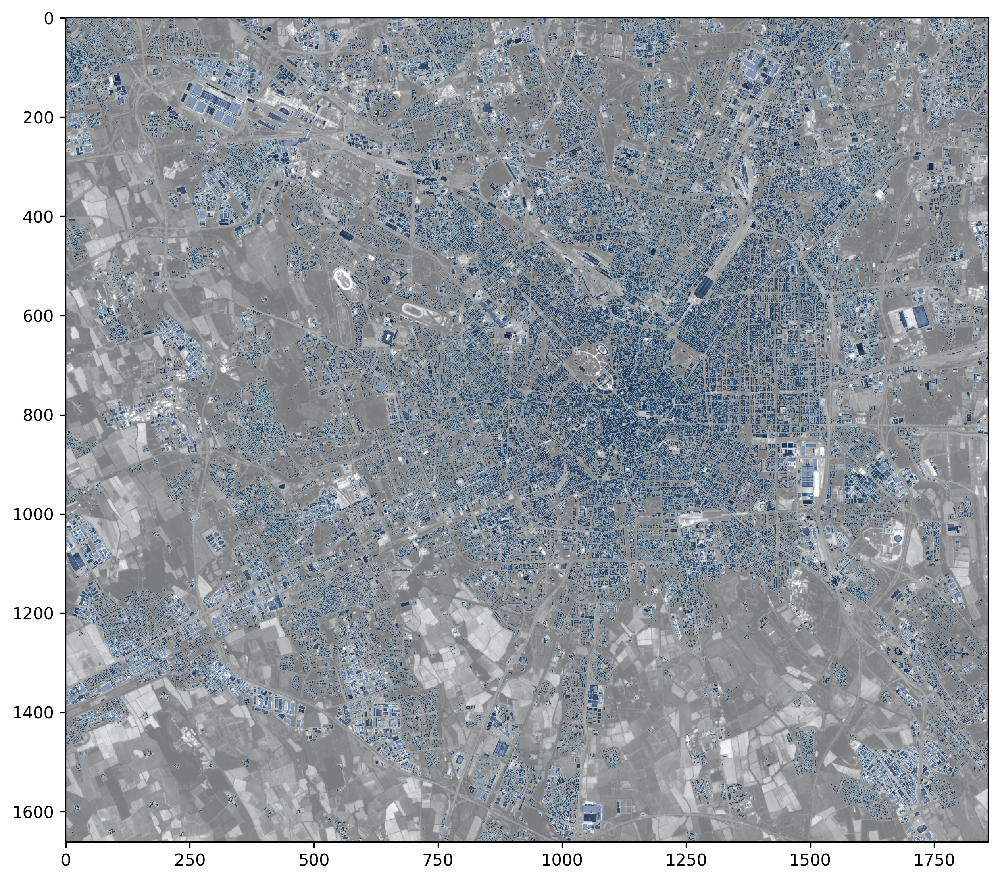

In [21]:
milan_sentinel_dir = SENTINEL_DATASET_DIR / "milan"
milan_building_dir = BUILDING_DATASET_DIR / "milan"
r_data = rasterio.open(milan_sentinel_dir / "R.tiff").read().squeeze()
r_data = normalize(r_data)

milan_buildings_raster = rasterio.open(milan_building_dir / "footprint.tiff").read().squeeze()

plt.figure(figsize=(10, 10), dpi=300)
plt.imshow(r_data, cmap="gray")
# plt.imshow(np.ma.masked_where(milan_buildings_raster == 0, milan_buildings_raster), cmap="coolwarm", alpha=1)
plt.imshow(milan_buildings_raster, cmap="Blues", alpha=0.5)
plt.savefig("bologna.png", dpi=300)

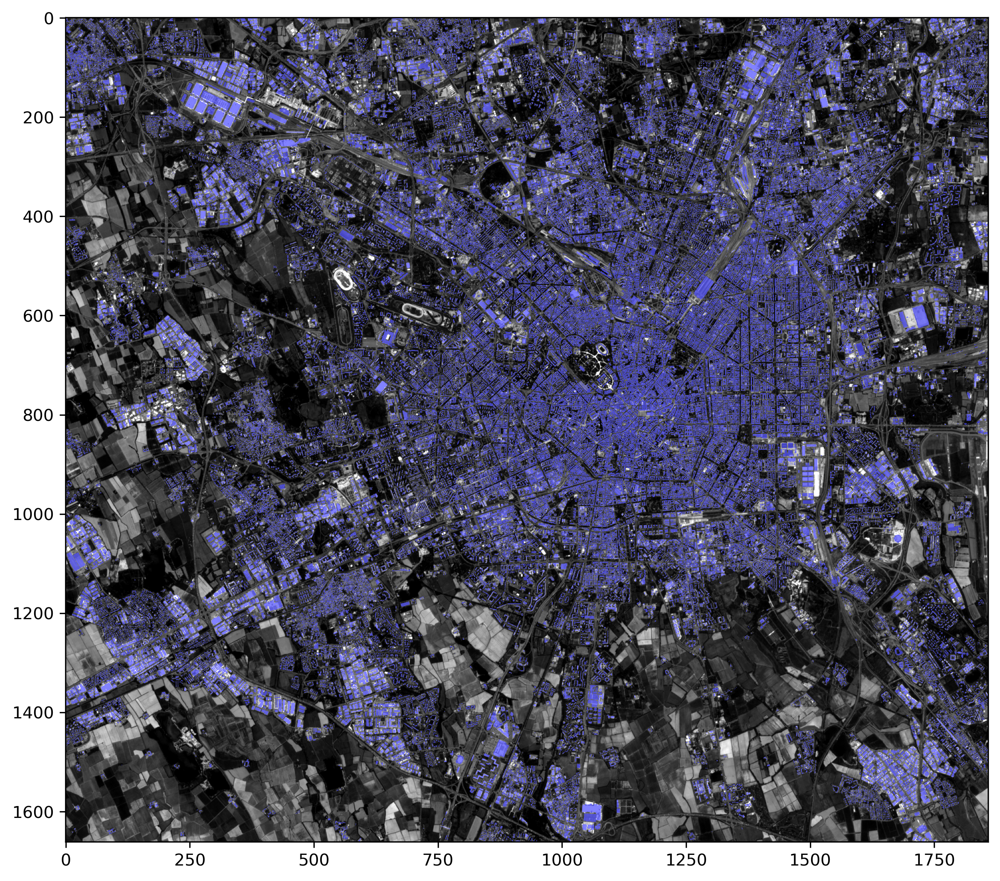

In [33]:
import matplotlib.colors
blue_cmap = matplotlib.colors.ListedColormap([(0,0,0,0), (0.3,0.3,1,0.7)])

plt.figure(figsize=(10, 10), dpi=300)
# plt.imshow(np.ma.masked_equal(milan_buildings_raster,0), cmap=blue_cmap, alpha=1)
plt.imshow(r_data, cmap="gray")
plt.imshow(milan_buildings_raster, cmap=blue_cmap, alpha=1)

In [60]:
buildings_raster.shape

(1548, 1665)